<a href="https://colab.research.google.com/github/ua-datalab/MLWorkshops/blob/main/Convolutional_Neural_Networks/CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%pip install lightning

# Training a CNN from scratch

CIFAR10: https://www.cs.toronto.edu/~kriz/cifar.html

60,000 32x32 color images in 10 classes, with 6000 images per class. We will train a model to predict the class, and evaluate it using top-3 accuracy, meaning that the classification will be considered correct if the true class is one of the top three predictions.

In [2]:
import os

import torch
from torch.utils.data import DataLoader, random_split
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision
from torchvision.datasets import CIFAR10
from torchvision import transforms

from torchmetrics import Accuracy

import lightning as L
from lightning.pytorch.callbacks.early_stopping import EarlyStopping
from lightning.pytorch.callbacks import ModelSummary

In [3]:
transform = transforms.Compose([transforms.ToTensor()])

# Loading the training dataset. We need to split it into a training and validation part
train_dataset = CIFAR10(os.getcwd(), train=True, transform=transform, download=True)
train_set, val_set = random_split(train_dataset, [40000, 10000])

# Loading the test set
test_set = CIFAR10(os.getcwd(), train=False, transform=transform, download=True)

# We define a set of data loaders that we can use for various purposes later.
train_loader = DataLoader(train_set, batch_size=256, shuffle=True, drop_last=True, pin_memory=True, num_workers=2)
val_loader = DataLoader(val_set, batch_size=256, shuffle=False, drop_last=False, num_workers=2)

test_batch_size = 8
test_loader = DataLoader(test_set, batch_size=test_batch_size, shuffle=True, drop_last=False, num_workers=2)

100%|██████████| 170498071/170498071 [00:06<00:00, 28366331.21it/s]


Extracting /content/cifar-10-python.tar.gz to /content
Files already downloaded and verified


In [4]:
class CNN(L.LightningModule):
    def __init__(self):
        super().__init__()

        self.accuracy = Accuracy(task='multiclass', num_classes=10, top_k=3)

        # Returns unnormalized logits. Output from forward must go through Softmax
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=3, kernel_size=(4,4)),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2,2)),
            nn.Conv2d(in_channels=3, out_channels=3, kernel_size=(4,4)),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2,2)),
            nn.Flatten(),
            nn.Linear(in_features=75, out_features=128), # why?
            nn.ReLU(),
            nn.Linear(in_features=128, out_features=10),
            nn.LogSoftmax(dim=1)
        )

    def forward(self, x):
        return self.layers(x)

    def _loss(self, batch):
        x, label = batch
        logits = self.layers(x)
        return F.nll_loss(logits, label)

    def training_step(self, batch, batch_idx):
        loss = self._loss(batch)
        self.log('train_loss', loss)
        return loss

    def validation_step(self, batch, batch_idx):
        x, labels = batch

        logits = self.forward(x)
        accuracy = self.accuracy(logits, labels)

        loss = self._loss(batch)

        metrics = {'val_accuracy': accuracy,
                   'val_loss': loss}

        self.log_dict(metrics)

    def test_step(self, batch, batch_idx):
        loss = self._loss(batch)
        self.log('test_loss', loss)

    def configure_optimizers(self):
        optimizer = optim.Adam(self.parameters(), lr=1e-3)
        return {'optimizer': optimizer, 'monitor': 'val_loss'}

In [5]:
cnn = CNN()
trainer = L.Trainer(accelerator='gpu',
                    devices=1,
                    callbacks=EarlyStopping(monitor='val_loss', mode='min', patience=3))

trainer.fit(cnn, train_loader, val_loader)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/lightning/pytorch/loops/utilities.py:73: `max_epochs` was not set. Setting it to 1000 epochs. To train without an epoch limit, set `max_epochs=-1`.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name     | Type               | Params
------------------------------------------------
0 | accuracy | MulticlassAccuracy | 0     
1 | layers   | Sequential         | 11.

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [6]:
# Start tensorboard.
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

In [7]:
import matplotlib.pyplot as plt
import numpy as np

In [8]:
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

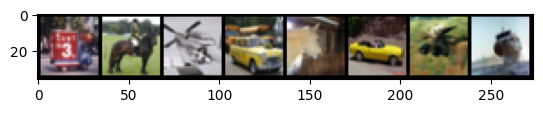

 truck  horse  plane  car  frog  car  horse  bird
62.50% accuracy


In [9]:
# get some random training images
dataiter = iter(test_loader)
images, labels = next(dataiter)
classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

# show images
imshow(torchvision.utils.make_grid(images))

# run inference, calculate accuracy
logits = cnn(images)
accuracy = Accuracy(task='multiclass', num_classes=10, top_k=3)
test_acc = accuracy(logits, labels)

predictions = torch.topk(logits, k=3, dim=1)
pred_classes = predictions.indices

# for each image, look up the top three predicted classes
all_pred_classes = []
for prediction in pred_classes:
    pred_classes = [classes[prediction[0]],
                    classes[prediction[1]],
                    classes[prediction[2]]]
    all_pred_classes.append(pred_classes)

# format strings as green if the prediction is correct, red if not
pred_strings = []
for i in range(len(labels)):
    label = labels[i]
    predictions = all_pred_classes[i]

    if classes[label] in predictions:
        pred_string = "\033[92m {}\033[00m".format(classes[label])

    # if the prediction is incorrect, use the highest probability guess
    else:
        pred_string = "\033[91m {}\033[00m".format(predictions[0])

    pred_strings.append(pred_string)

# print out the predicted classes and accuracy
print(' '.join(pred_strings))
print(f'{100*test_acc:.2f}% accuracy')

# Running a pre-trained CNN

In this next section we are going to be using pre-trained weights, meaning that we do not need to train a model.

The steps that are taken here are:

1. Loading the model and setup preprocessing of images
2. Write a function to perform detection on an image using torch and the pre-trained model
3. Write a function that creates boxes and labels
4. Wrote a function that shows the results

In [10]:
# Downloading images
!wget -O apples_board.png https://media.post.rvohealth.io/wp-content/uploads/2020/09/health-benefits-of-apples-1200x628-facebook-1200x628.jpg
!wget -O apples_table.png https://i0.wp.com/blog.blueapron.com/wp-content/uploads/2020/09/fall_apple_varieties-1.jpg?fit=1920%2C1228&ssl=1
!wget -O verbena.png https://github.com/ua-datalab/MLWorkshops/blob/main/images/CNN/verbena.png?raw=true
!wget -O merri.png https://github.com/ua-datalab/MLWorkshops/blob/main/images/CNN/merri2.png?raw=true

--2024-04-04 05:39:03--  https://media.post.rvohealth.io/wp-content/uploads/2020/09/health-benefits-of-apples-1200x628-facebook-1200x628.jpg
Resolving media.post.rvohealth.io (media.post.rvohealth.io)... 18.239.69.96, 18.239.69.113, 18.239.69.60, ...
Connecting to media.post.rvohealth.io (media.post.rvohealth.io)|18.239.69.96|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 129282 (126K) [image/jpeg]
Saving to: ‘apples_board.png’

apples_board.png    100%[===================>] 126.25K  --.-KB/s    in 0.008s  

2024-04-04 05:39:03 (15.2 MB/s) - ‘apples_board.png’ saved [129282/129282]

--2024-04-04 05:39:03--  https://i0.wp.com/blog.blueapron.com/wp-content/uploads/2020/09/fall_apple_varieties-1.jpg?fit=1920%2C1228
Resolving i0.wp.com (i0.wp.com)... 192.0.77.2
Connecting to i0.wp.com (i0.wp.com)|192.0.77.2|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 193129 (189K) [image/jpeg]
Saving to: ‘apples_table.png’

apples_table.png    100%[=

In [11]:
import torch

import torchvision
from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn

from PIL import Image, ImageDraw
import requests
from io import BytesIO

# Load the pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Modify the transformation for input images
transform = transforms.Compose([
    transforms.ToTensor()
])

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 145MB/s]


In [12]:
# Function to perform object detection on an image
def detect_objects(model, image, threshold=0.5):
    # Transform the input image
    input_image = transform(image).unsqueeze(0)

    # Perform inference
    with torch.no_grad():
        prediction = model(input_image)

    # Filter out predictions below the threshold
    boxes = prediction[0]['boxes'][prediction[0]['scores'] > threshold]
    scores = prediction[0]['scores'][prediction[0]['scores'] > threshold]
    labels = prediction[0]['labels'][prediction[0]['scores'] > threshold]

    return boxes, scores, labels

In [13]:
# Function to draw bounding boxes and labels on the image
def draw_boxes(image, boxes, scores, labels):
    draw = ImageDraw.Draw(image)
    for box, score, label in zip(boxes, scores, labels):
        draw.rectangle([box[0], box[1], box[2], box[3]], outline="red", width=3)
        draw.text((box[0], box[1]), f"Label: {label}, Score: {score:.2f}", fill="red")
    return image

In [14]:
# Function to visualize the detection results
def visualize_results(image, boxes, scores, labels):
    image_with_boxes = draw_boxes(image, boxes, scores, labels)
    display(image_with_boxes)

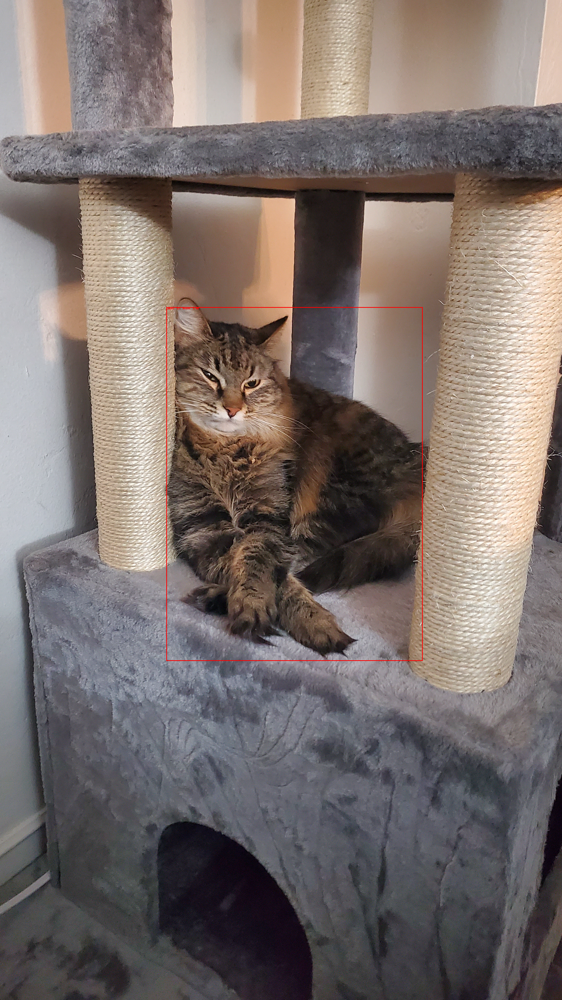

In [15]:
# Example image path
image_path = "merri.png"

# Load image and perform object detection
image = Image.open(image_path)

boxes, scores, labels = detect_objects(model, image, threshold=0.5)

# Visualize the results
visualize_results(image, boxes, scores, labels)